#### Fork process creation method

Include the analysis script and setup the folders with raw data

In [14]:
from benchmarking.analysis.analyze_results import *

In [15]:
output_base_folder = Path("/iarai/home/ivan.svogor/git/storage-benchmarking/benchmark_output/")
s3_folder_filter="updated_lightning/s3/*benchmark_e2e*"
scratch_folder_filter="updated_lightning/scratch/*benchmark_e2e*"

#### Load raw data

In [16]:
df_dataloader_s3 = extract_timelines(output_base_folder, folder_filter=s3_folder_filter)
df_dataloader_scratch = extract_timelines(output_base_folder, folder_filter=scratch_folder_filter)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 321/321 [00:27<00:00, 11.83it/s]


In [17]:
# Show data (to check if loaded correctly)

# df_dataloader_s3.sort_values(["start_time_x"], ascending=False)
# df_dataloader_scratch.sort_values(["start_time_x"`], ascending=False)

In [18]:
# extract unique functions (for s3 and scratch, it's the same)
unique_functions_s3 = np.unique(df_dataloader_s3["item_x"])

# define colors for timelane items 
colors = {}
for i, color in zip(unique_functions_s3, ["red", "gold", "blue", "magenta", "aqua"]):
    colors[str(i)] = color
    
# define lanes (each lane is for a single function call (i.e. usage))
lanes={}
for i, lane in zip(unique_functions_s3, range(len(unique_functions_s3))):
    lanes[str(i)] = lane

# print to verify
print(f"Unique functions: {unique_functions_s3}")
print(f"Lanes: {lanes}")
    
# get the names of the runs for the iterators later on 
unique_runs_s3 = np.unique(df_dataloader_s3["run"])
unique_runs_scratch = np.unique(df_dataloader_scratch["run"])

Unique functions: ['batch' 'next_data' 'run_training_batch' 'training_batch_to_device']
Lanes: {'batch': 0, 'next_data': 1, 'run_training_batch': 2, 'training_batch_to_device': 3}


#### Timeline plots

Each line corresponds to a unique function call.

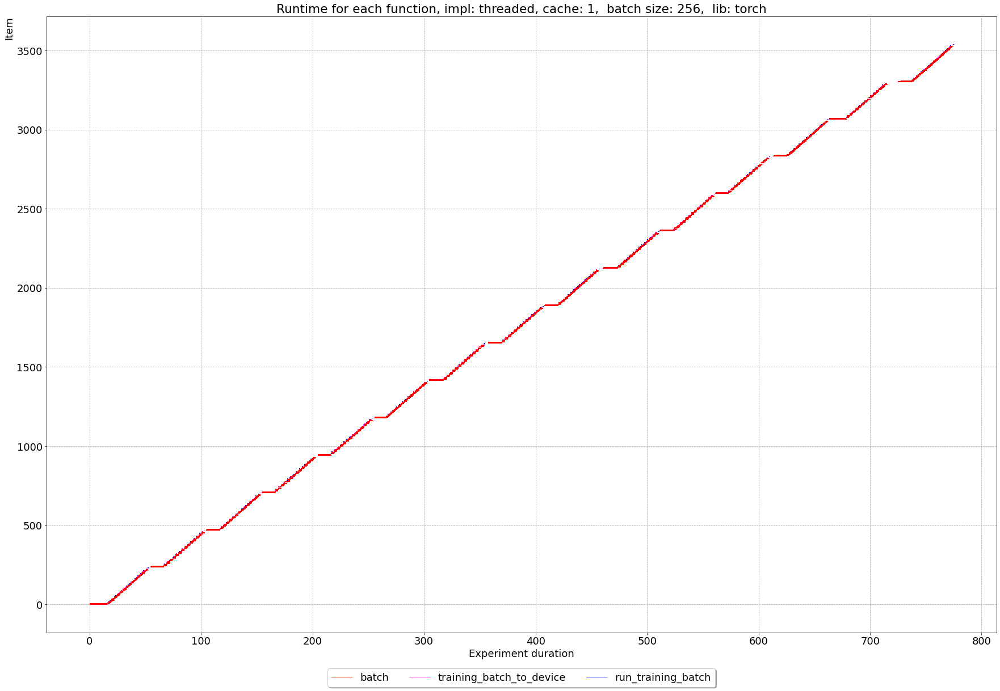

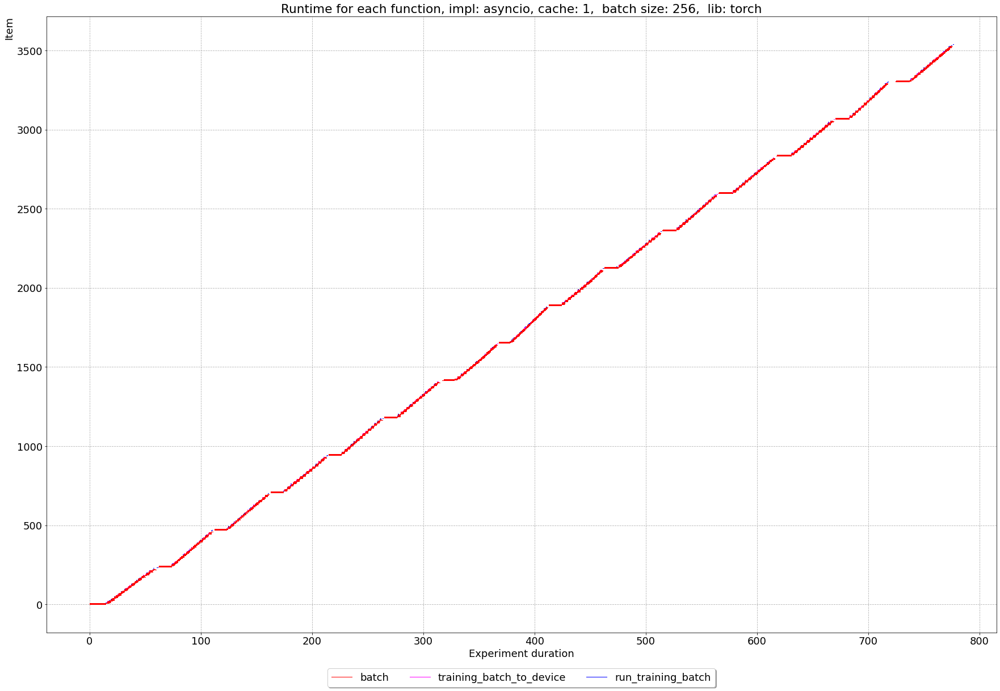

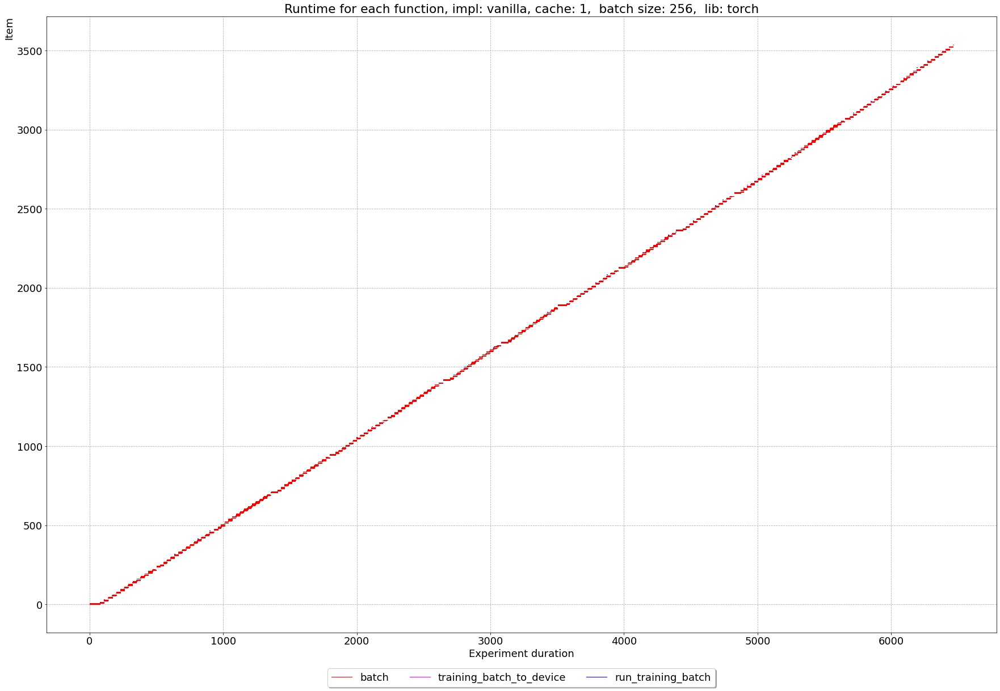

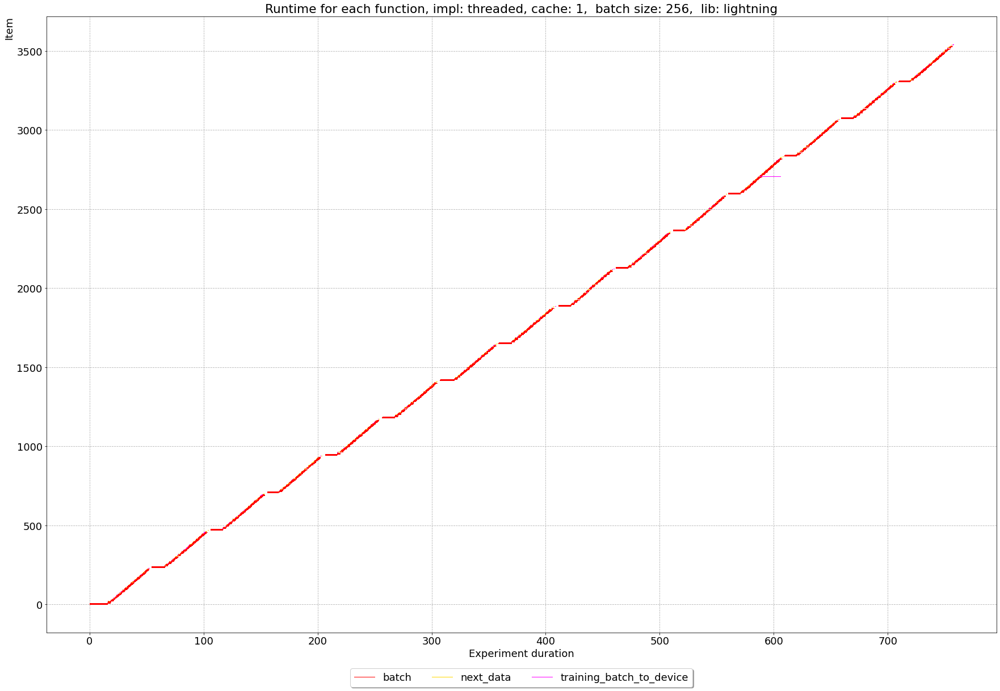

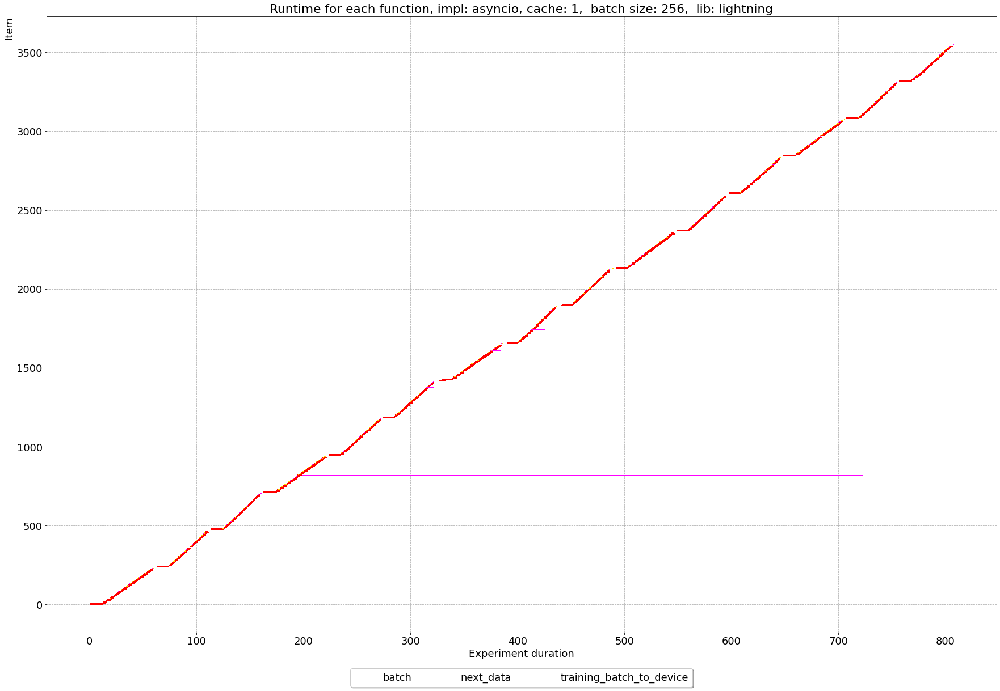

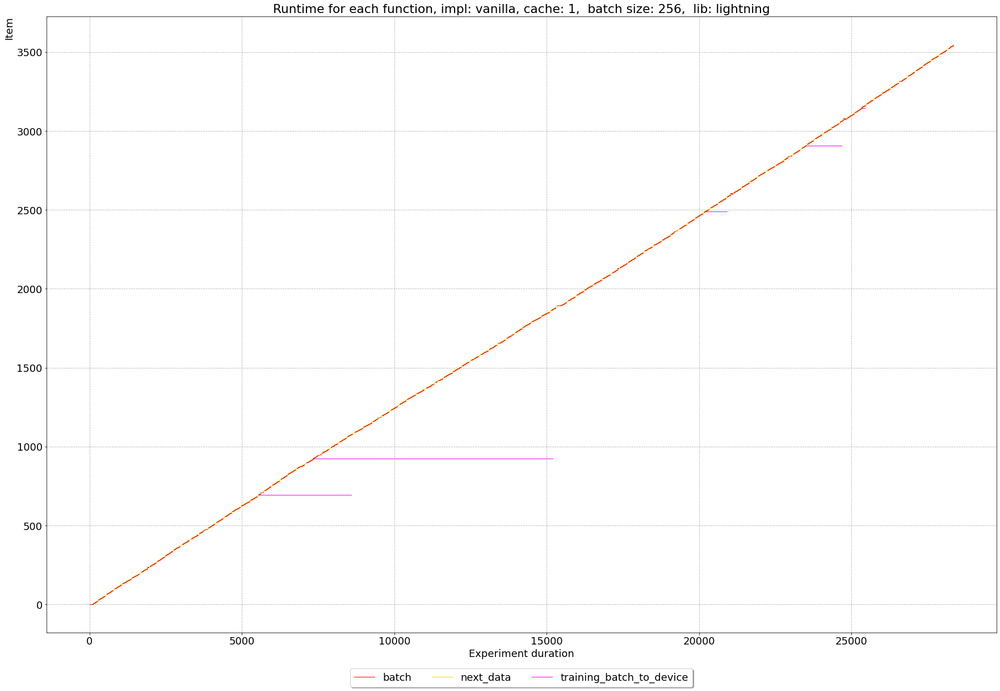

In [19]:
for implementation in ["torch", "lightning"]:
    for run in unique_runs_s3:
        if implementation in run:
            df = df_dataloader_s3[(df_dataloader_s3["run"]==run)]
            show_timelines(df, run, lanes, colors, False, False, 1)

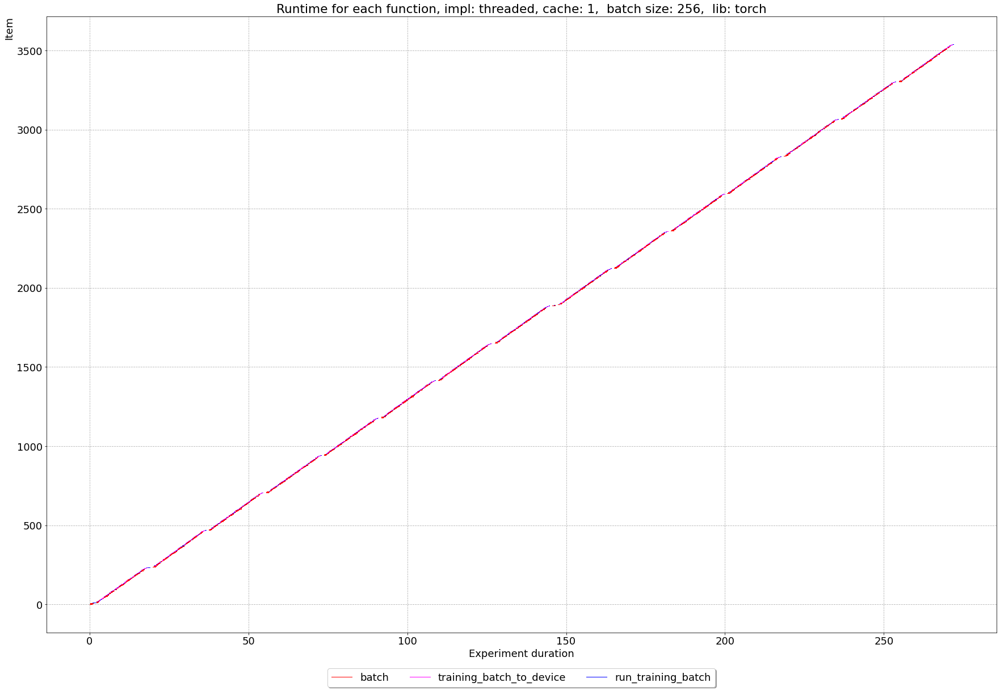

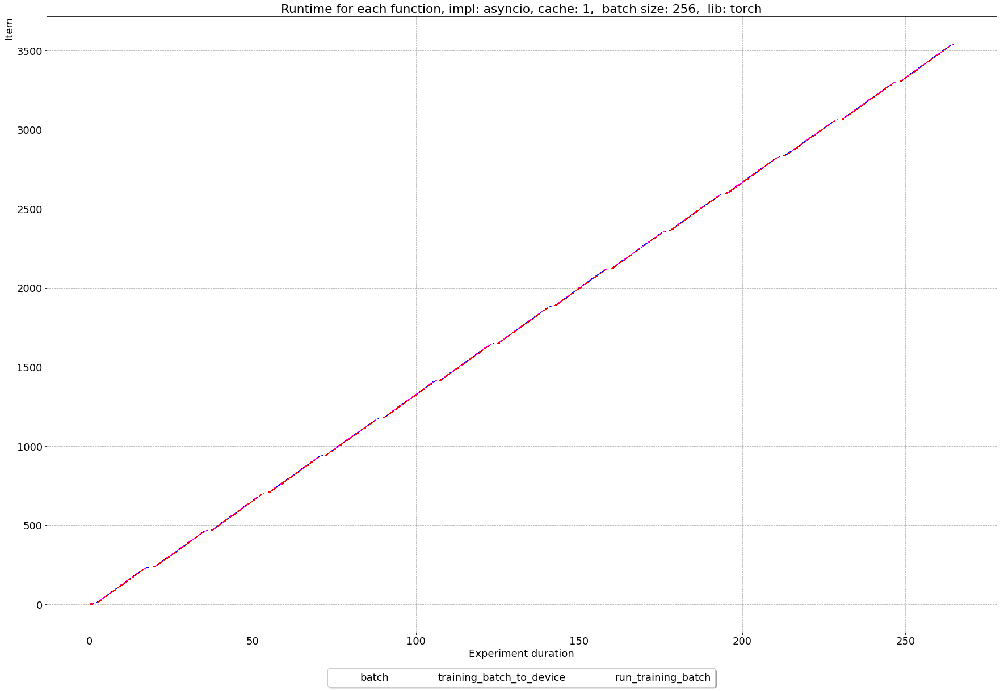

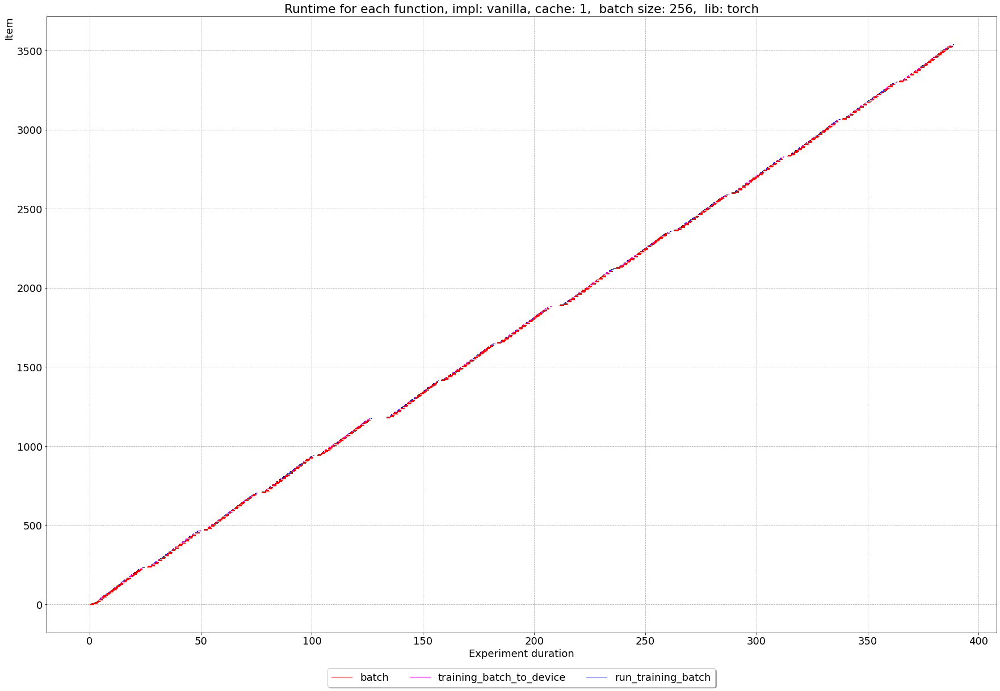

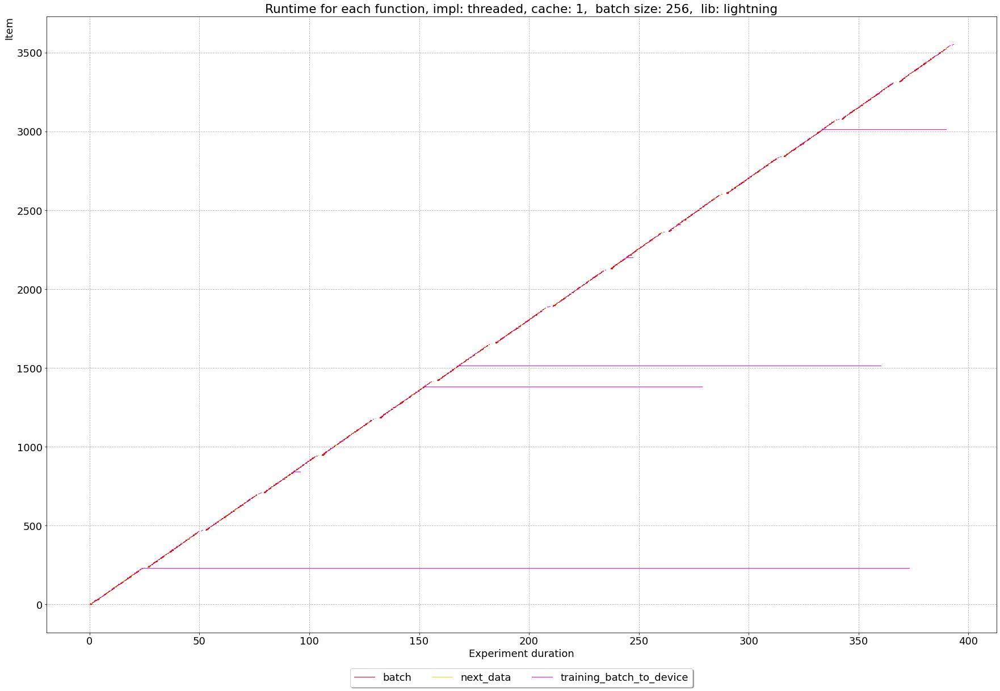

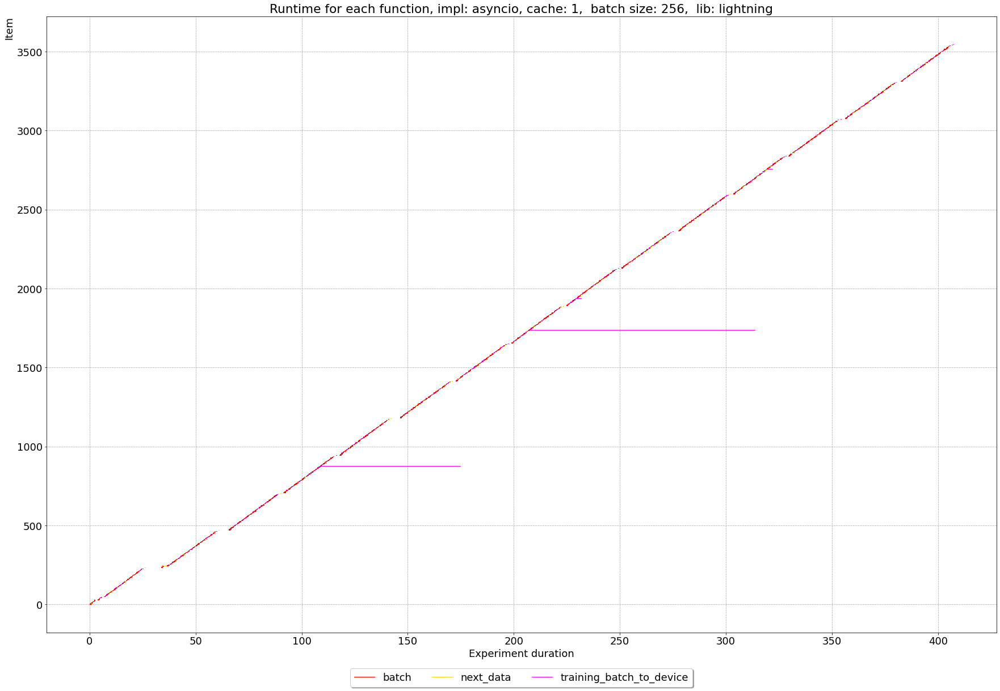

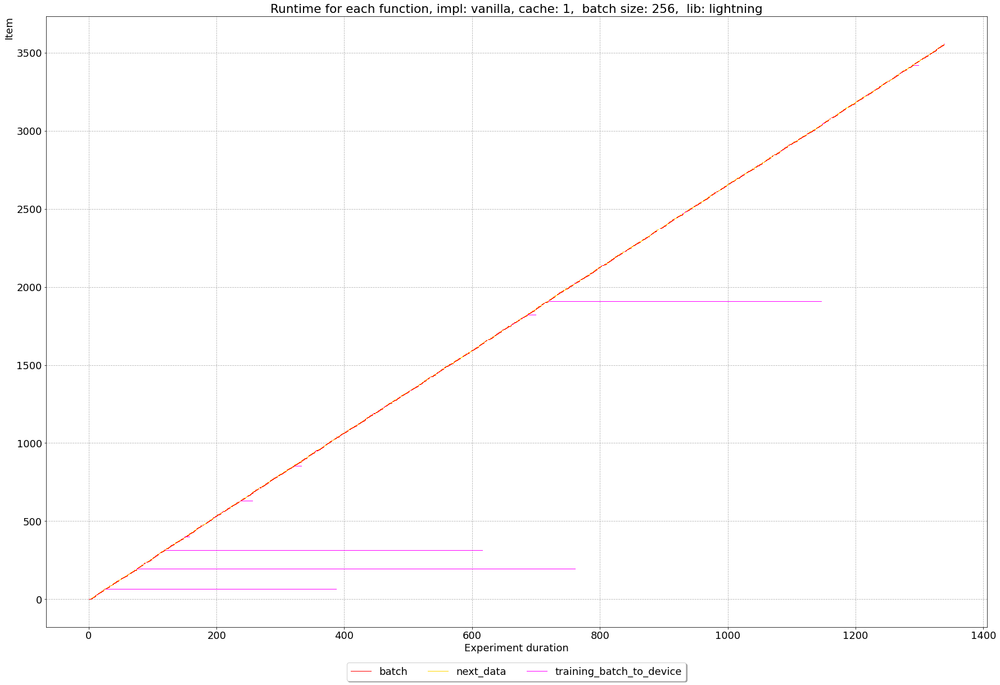

In [20]:
for implementation in ["torch", "lightning"]:
    for run in unique_runs_scratch:
        if implementation in run:
            df = df_dataloader_scratch[(df_dataloader_scratch["run"]==run)]
            show_timelines(df, run, lanes, colors, False, False, 1)

### GPU Utilization

In [21]:
# Load the GPU utilization 
df_gpuutil_s3 = extract_gpuutil(output_base_folder, folder_filter=s3_folder_filter)
df_gpuutil_scratch = extract_gpuutil(output_base_folder, folder_filter=scratch_folder_filter)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 321/321 [00:11<00:00, 26.89it/s]


In [22]:
unique_runs_s3 = np.unique(df_dataloader_s3["run"])
unique_runs_scratch = np.unique(df_dataloader_scratch["run"])
print(unique_runs_s3, unique_runs_scratch)

['20220124f214752_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync'
 '20220124f220054_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync'
 '20220124f222530_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync'
 '20220124f223912_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync'
 '20220124f230713_benchmark_e2e_lightning_s3_256_4_16_1_vanilla_sync'
 '20220125f070123_benchmark_e2e_torch_s3_256_4_16_1_vanilla_sync'] ['20220124f221405_benchmark_e2e_lightning_scratch_256_4_16_1_threaded_sync'
 '20220124f222050_benchmark_e2e_torch_scratch_256_4_16_1_threaded_sync'
 '20220124f225325_benchmark_e2e_lightning_scratch_256_4_16_1_asyncio_sync'
 '20220124f230126_benchmark_e2e_torch_scratch_256_4_16_1_asyncio_sync'
 '20220125f085231_benchmark_e2e_lightning_scratch_256_4_16_1_vanilla_sync'
 '20220125f091542_benchmark_e2e_torch_scratch_256_4_16_1_vanilla_sync']


59.00776397515528 22.914285714285715


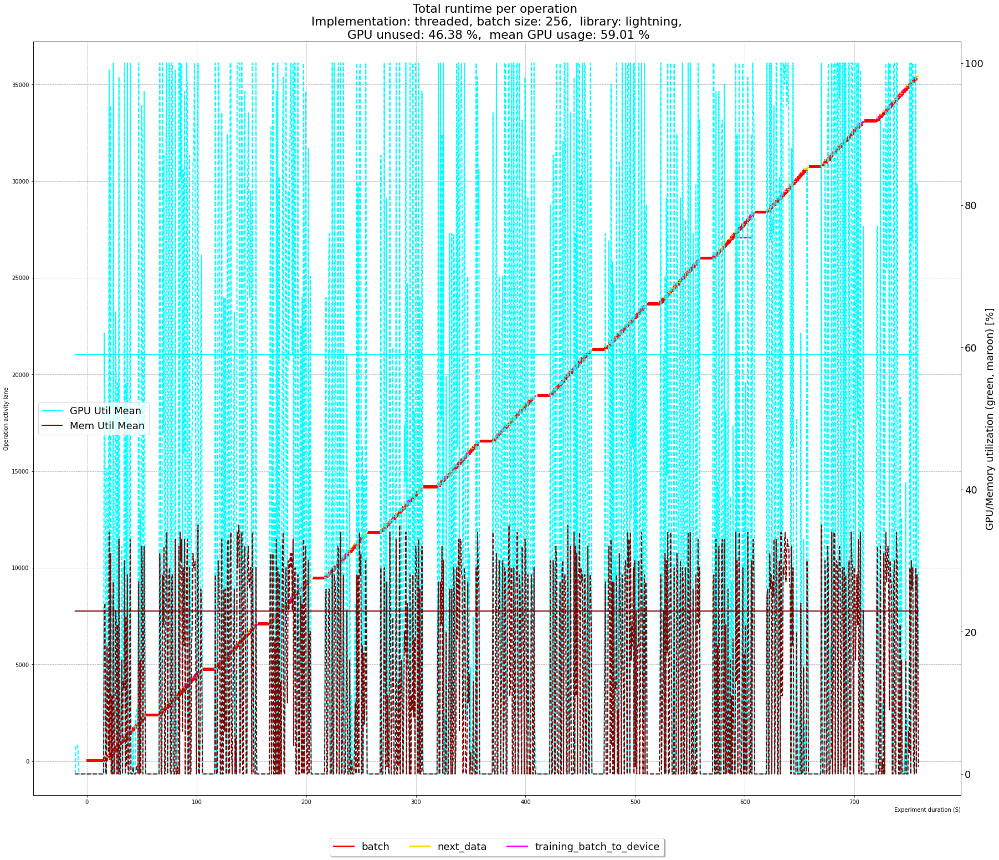

59.37096774193548 35.357142857142854


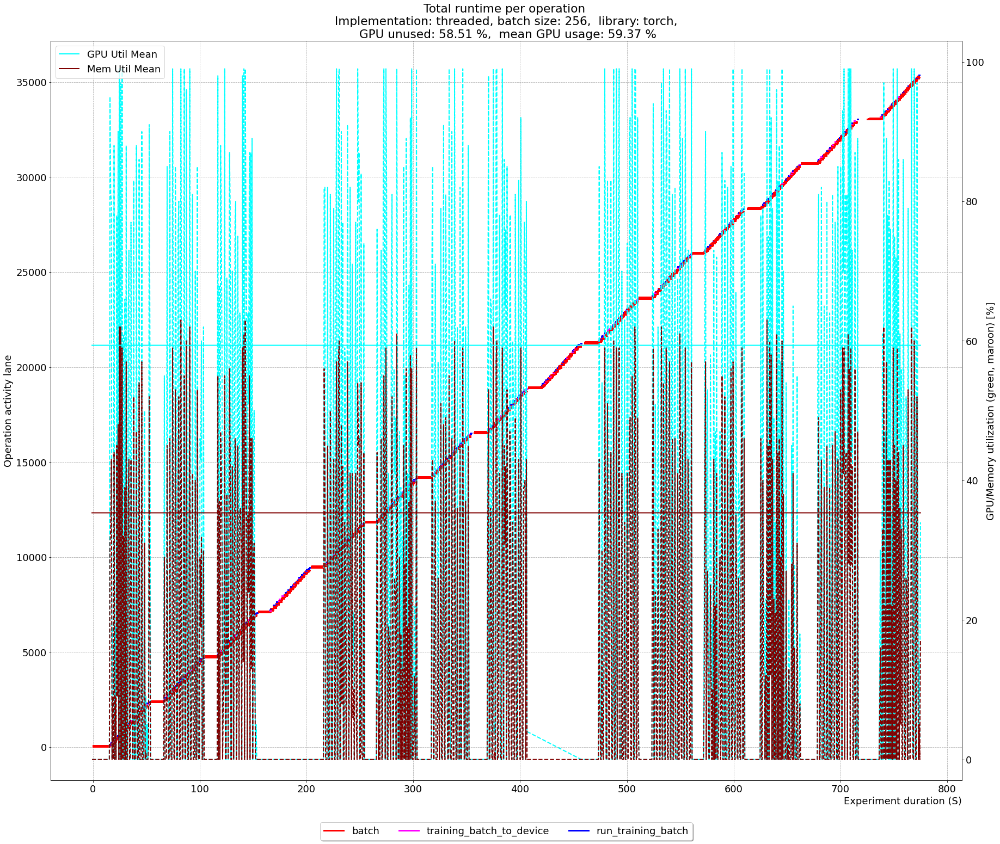

59.41598694942904 22.90018832391714


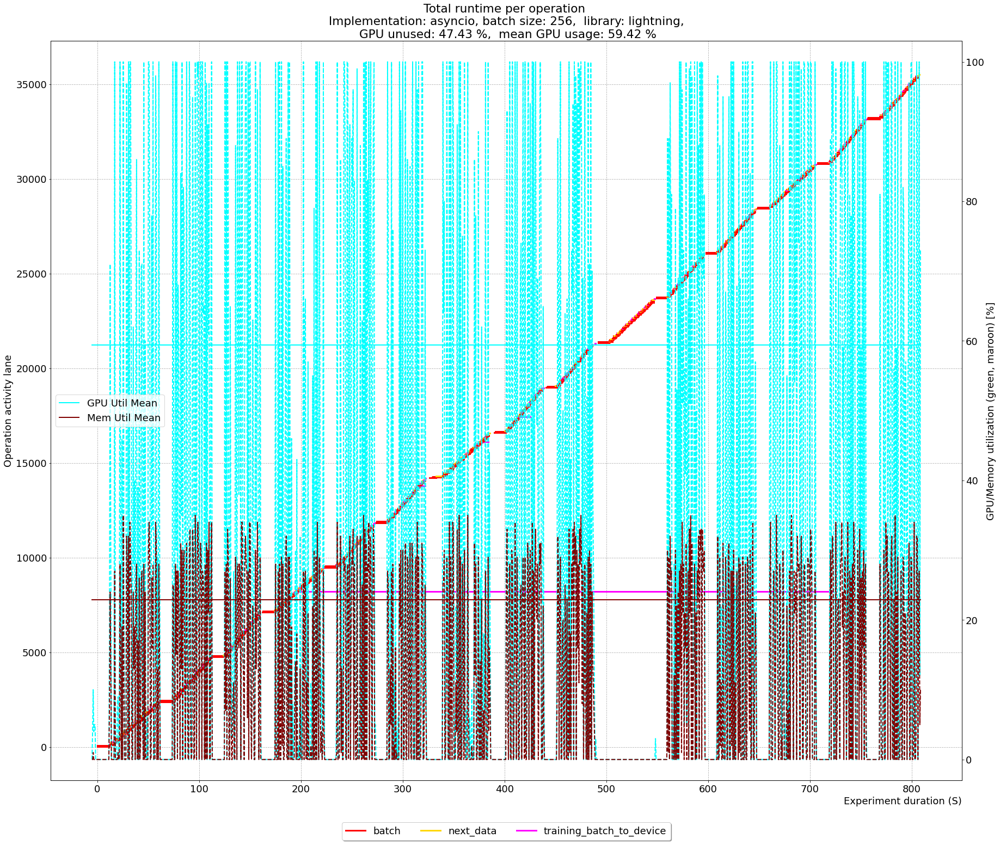

59.82921810699588 35.3141592920354


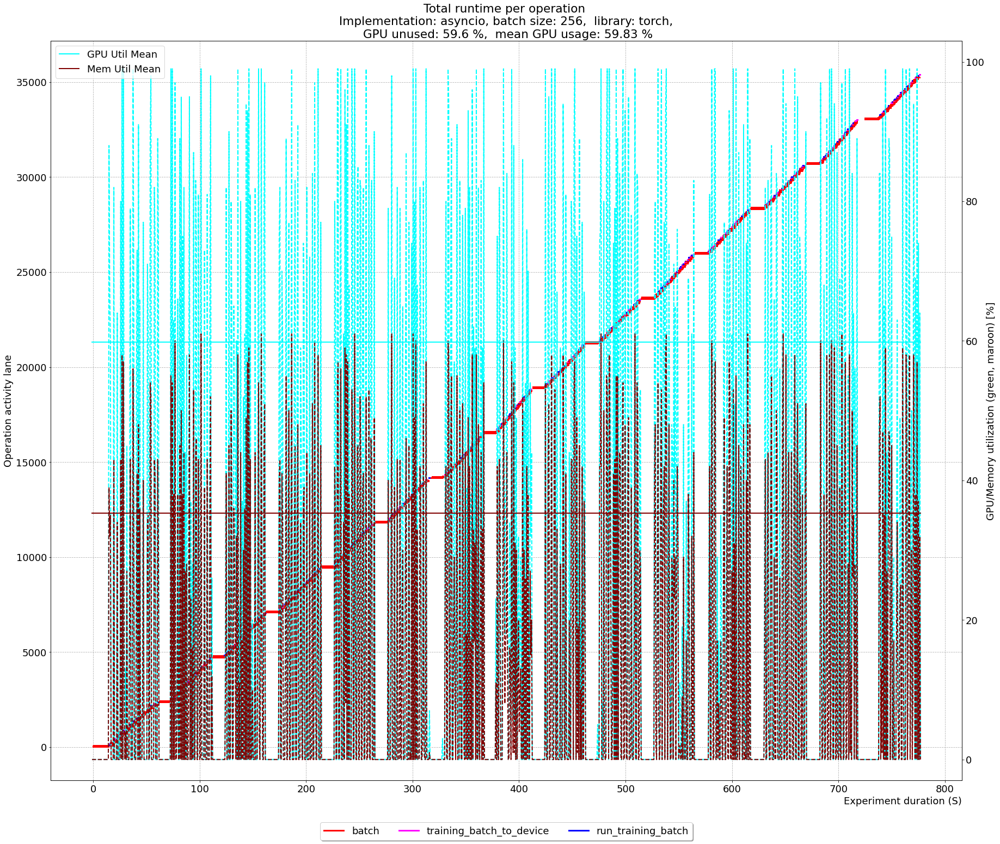

58.52425876010782 22.78864353312303


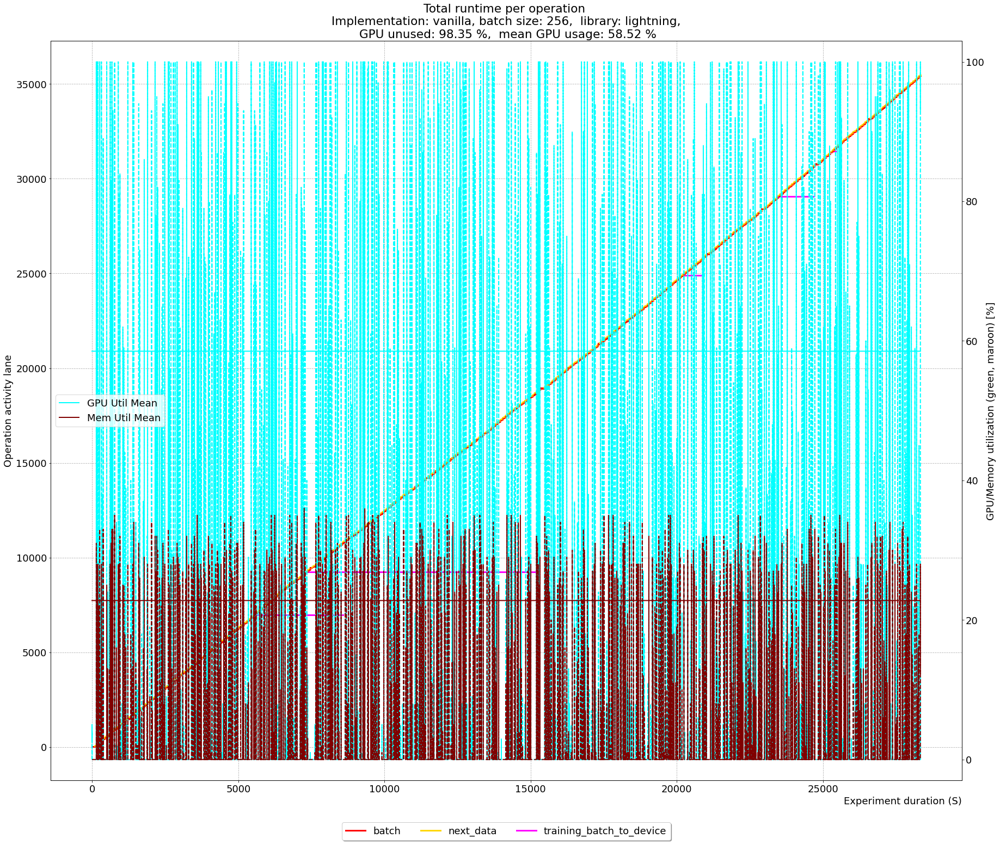

63.734883720930235 38.39386189258312


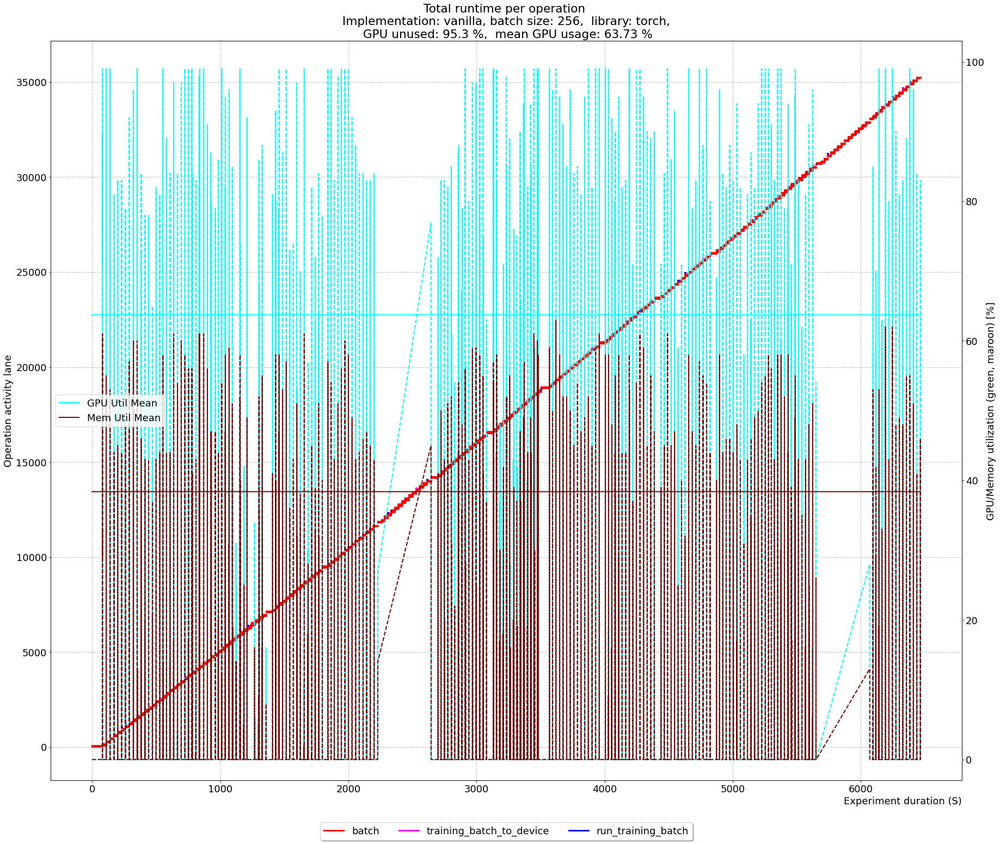

In [9]:
returns_s3 = []
for run in sorted(unique_runs_s3):
    df = df_dataloader_s3[df_dataloader_s3["run"]==run]
    dfgpu = df_gpuutil_s3[df_gpuutil_s3["run"]==run]
    returns_s3.append(show_timelines_with_gpu(df, dfgpu, lanes, colors, run, False, True, False, 2))

69.09012131715771 24.874538745387454


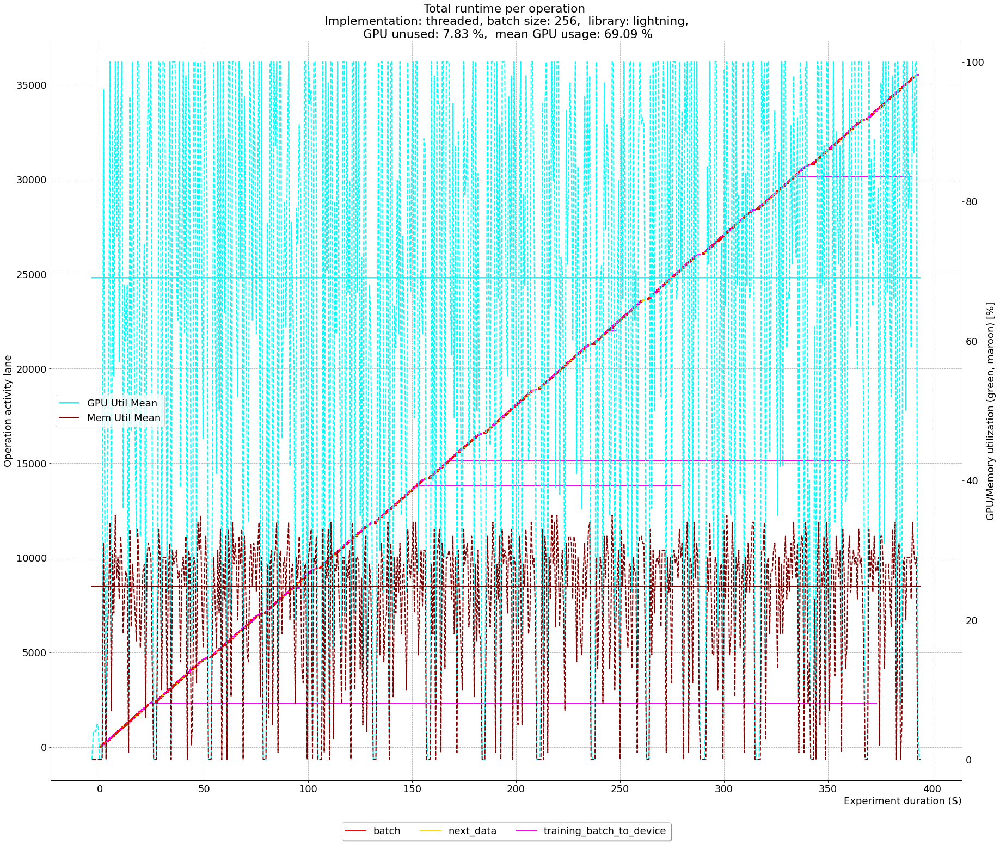

80.50895140664962 44.987146529562985


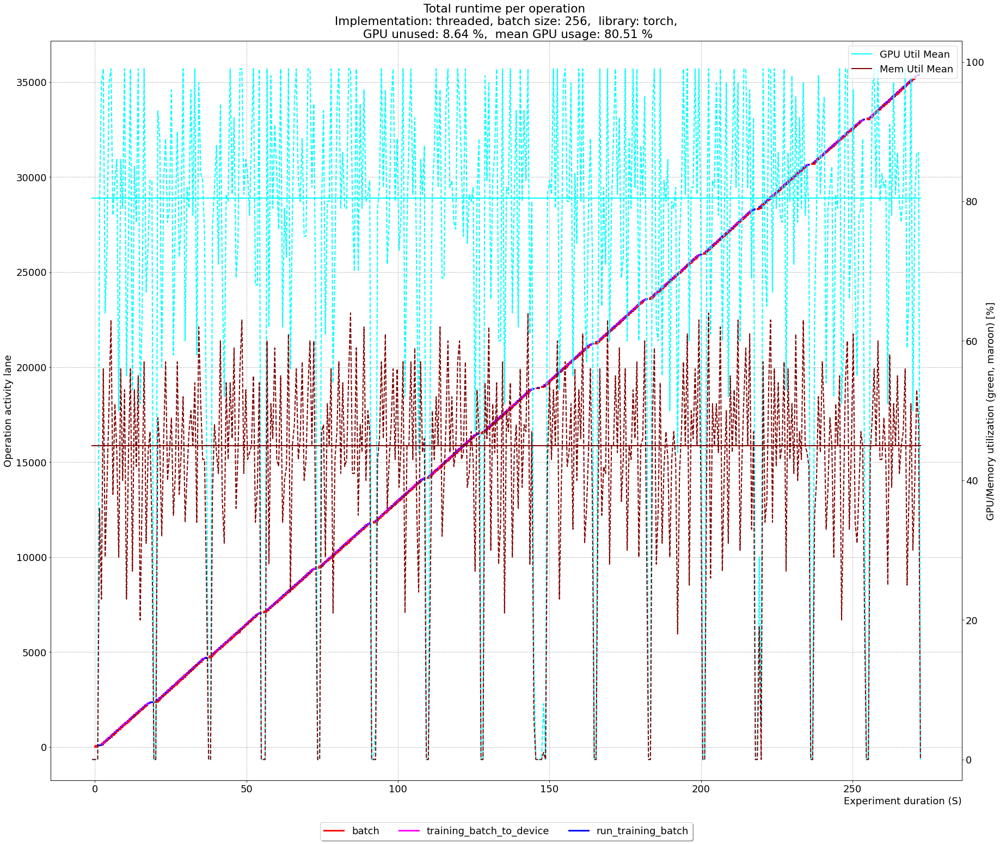

71.20970537261698 24.926126126126125


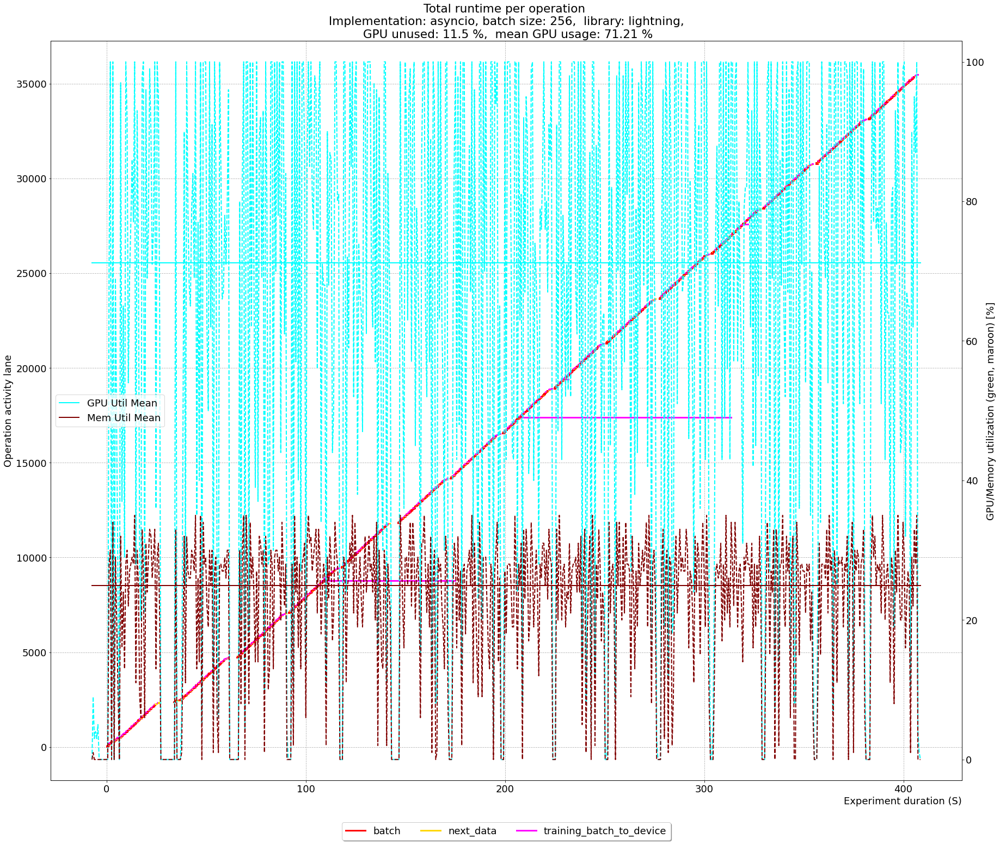

80.14021164021165 46.753315649867375


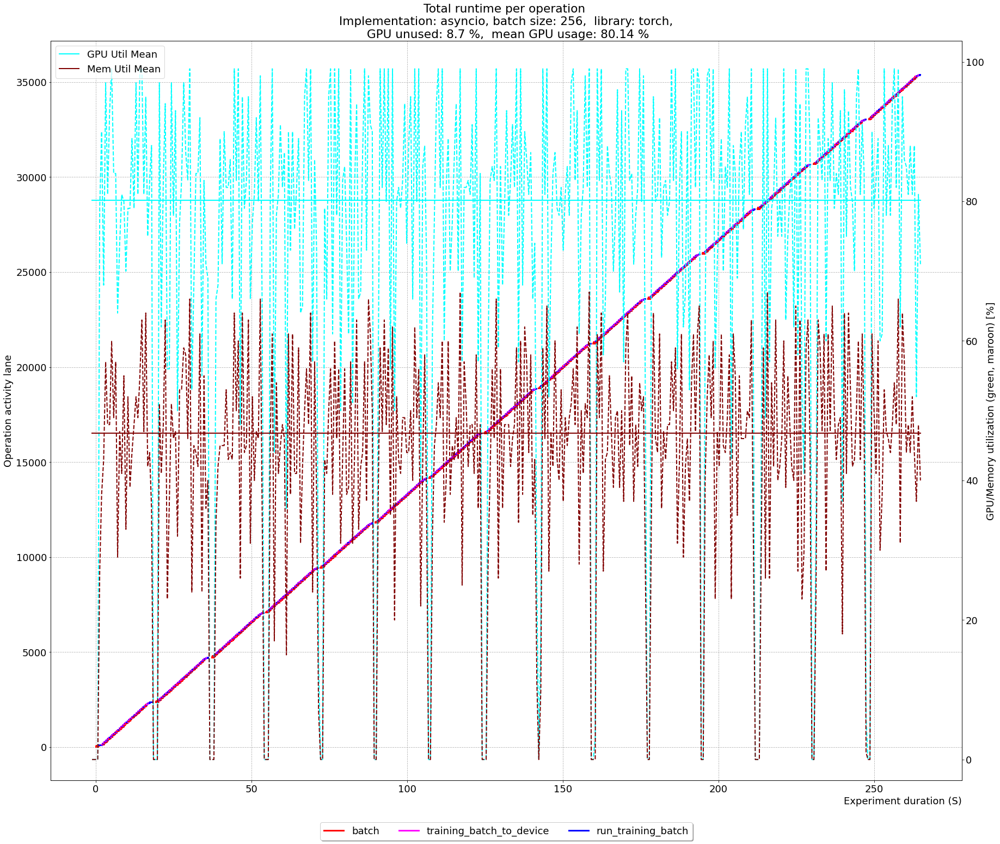

56.818304172274566 22.212074303405572


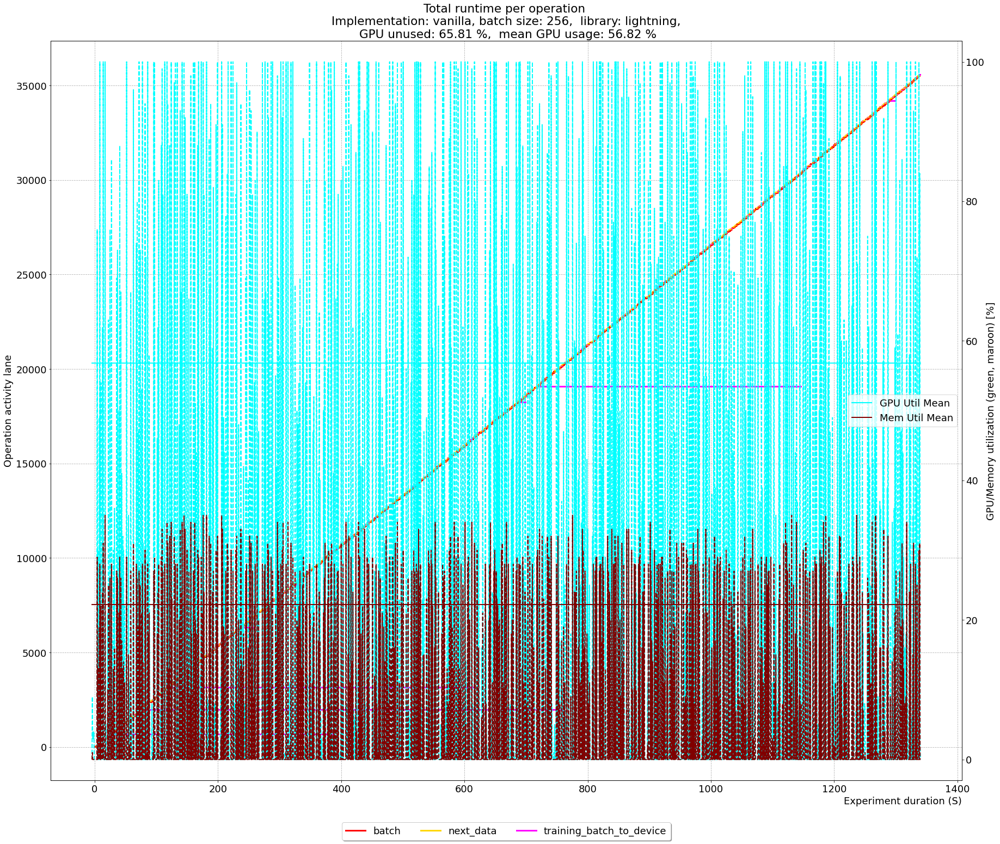

69.8798076923077 41.1625


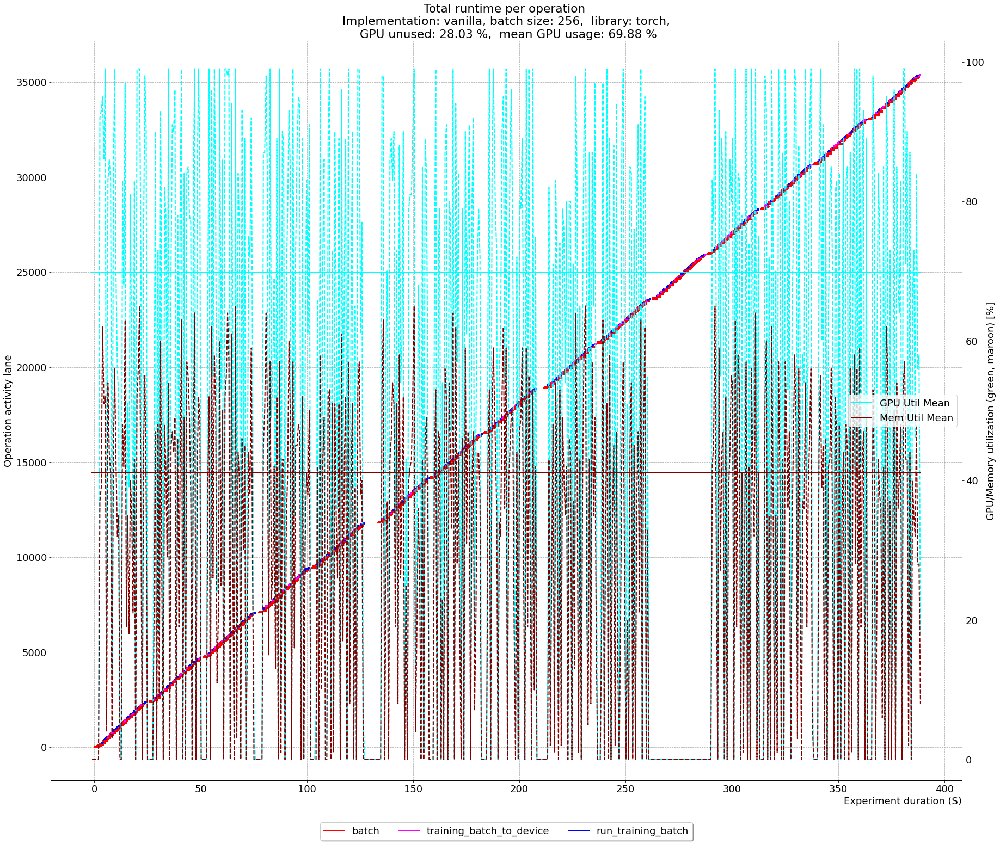

In [10]:
returns_scratch = []
for run in sorted(unique_runs_scratch):
    df = df_dataloader_scratch[df_dataloader_scratch["run"]==run]
    dfgpu = df_gpuutil_scratch[df_gpuutil_scratch["run"]==run]
    returns_scratch.append(show_timelines_with_gpu(df, dfgpu, lanes, colors, run, False, True, False, 2))

### Result tables

The following two tables display throughput details for both experiments. The default sample size, i.e. number of dataset items is 3000.

In [23]:
samples = 15000

In [26]:
# S3
results_s3 = pd.DataFrame.from_records(data=returns_s3)
results_s3["throughput"] = samples / results_s3["runtime"]
results_s3.sort_values(["runtime", "library"], ascending=True)

,runtime,gpu_util_zero,gpu_util_mean_no_zeros,mem_util_mean,mem_util_mean_no_zeros,implementation,cache,library,throughput
0,757.381185,46.378018,59.007764,10.684430,22.914286,threaded,1,lightning,19.805087
1,774.571519,58.508604,59.370968,13.723709,35.357143,threaded,1,torch,19.365546
3,776.381118,59.600998,59.829218,13.268495,35.314159,asyncio,1,torch,19.320408
2,807.336037,47.427101,59.415987,10.428816,22.900188,asyncio,1,lightning,18.579624
5,6464.950499,95.296948,63.734884,1.641912,38.393862,vanilla,1,torch,2.320203
4,28338.814996,98.350598,58.524259,0.321167,22.788644,vanilla,1,lightning,0.529309


In [27]:
# Scratch
results_scratch = pd.DataFrame.from_records(data=returns_scratch)
results_scratch["throughput"] = samples / results_scratch["runtime"]
results_scratch.sort_values(["runtime", "library"], ascending=True)

,runtime,gpu_util_zero,gpu_util_mean_no_zeros,mem_util_mean,mem_util_mean_no_zeros,implementation,cache,library,throughput
3,264.572706,8.695652,80.140212,42.574879,46.753316,asyncio,1,torch,56.695191
1,271.787639,8.644860,80.508951,40.887850,44.987147,threaded,1,torch,55.190148
5,388.493243,28.027682,69.879808,28.486159,41.162500,vanilla,1,torch,38.610710
0,393.032009,7.827476,69.090121,21.536741,24.874539,threaded,1,lightning,38.164830
2,407.109994,11.503067,71.209705,21.217791,24.926126,asyncio,1,lightning,36.845079
4,1338.656904,65.807639,56.818304,6.603313,22.212074,vanilla,1,lightning,11.205261


### Forced violins

#### S3

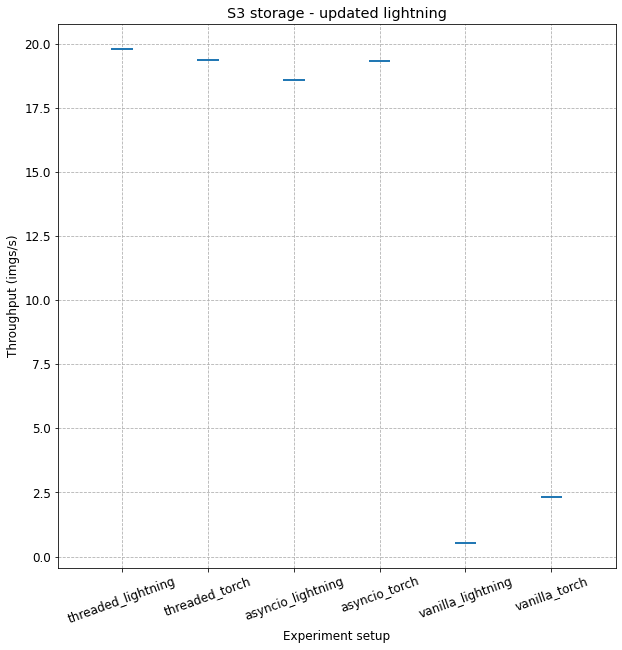

In [32]:
# since the experiment was not repeated, there is not array of values to plot in violin
# so here is a not-so-clever workaround 

df = pd.DataFrame()
def add_stats(row):
    line = [row["throughput"]] * 3
    line.append(0.0)
    line.append(0.0)
    new_row = pd.DataFrame([pd.Series(line)], index = [row["implementation"] + "_" + row["library"]])
    return df.append(new_row)

# add to df
for index, row in results_s3.iterrows():
    df = add_stats(row)

# give names
df.columns = [0, 1, "mean", "std_dev", "var"]
plot_violins(df, "S3 storage - updated lightning") # 

#### Scratch

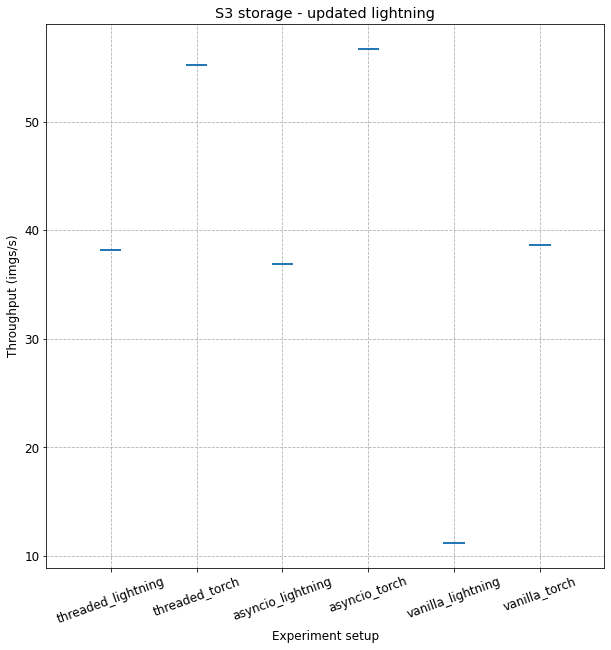

In [33]:
# add to df
df = pd.DataFrame()
for index, row in results_scratch.iterrows():
    df = add_stats(row)

# give names
df.columns = [0, 1, "mean", "std_dev", "var"]
plot_violins(df, "S3 storage - updated lightning") # 